In [1]:
import os 
os.chdir("..")

In [2]:
!pwd

/Users/wiktorlazarski/Desktop/my_project/face-morphing


In [16]:
from face_morphing.image_processing import PreprocessingPipeline
import matplotlib.pyplot as plt
import cv2
import face_morphing.morphing_pipeline as mp
import torch
import os
import scripts.training.data_loading as dl

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
ROOT = "/Users/wiktorlazarski/Desktop/my_project/face-morphing"
os.chdir(ROOT)

In [5]:
DATASET_ROOT = os.path.join(ROOT, "./data/dataset/test/")

In [6]:
nn_image_input_resolution=256

In [7]:
pipeline = PreprocessingPipeline(nn_image_input_resolution=nn_image_input_resolution)

In [8]:
dataset = dl.HelenFaceMorphingDataset(dataset_root=DATASET_ROOT, preprocess_pipeline=None)

In [23]:
def plot_with_points(img, keypoints):
    _, ax = plt.subplots()
    #img = img.detach().permute(1, 2, 0).numpy()
    ax.imshow(img)
    for x, y in keypoints:
        ax.scatter(x, y, c='r', s=10)
        
    plt.show()

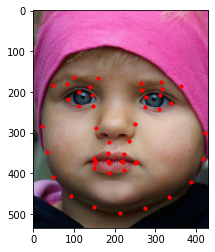

In [24]:
plot_with_points(*dataset[5])

In [25]:
pipeline = mp.FaceMorphingPipeline()

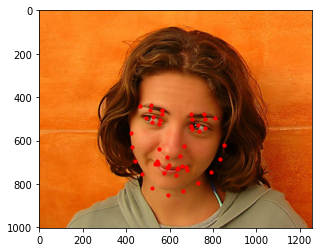

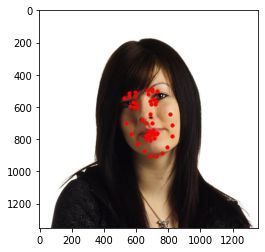

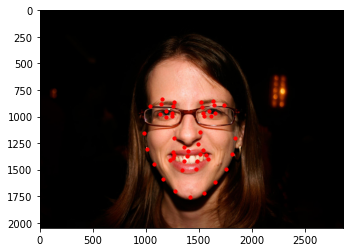

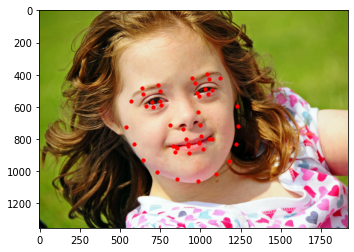

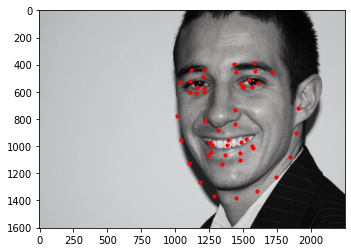

...

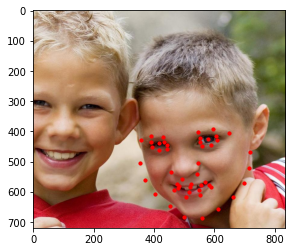

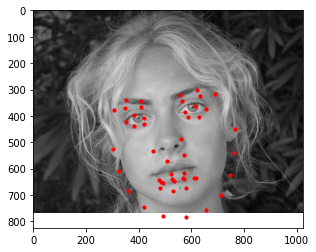

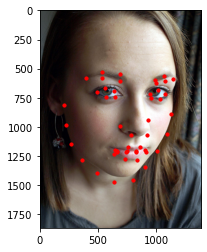

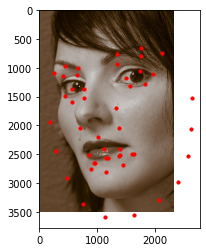

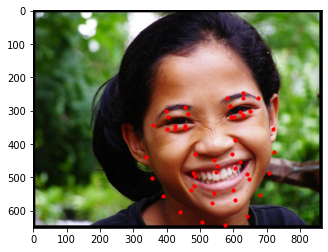

In [26]:
from pathlib import Path

for image in (Path(DATASET_ROOT) / "images").glob("*.jpg"):
    img = cv2.imread(str(image))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    predicted_kps = pipeline(img)
    plot_with_points(img, predicted_kps)